# Load libraries and modules

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
import time
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

from modules.full_pipeline_evaluation_ensemble import generate_predictions_ensemble

# S01: Single step small (5 years training)

Reading confing file and setting up folders...
Loading data to RAM...
Time: 2.16s
########Epoch 11########

Model 1
	Loading existing predictions
RMSE 
	Z500 - 0: 62.745324264180034
	T850 - 0: 0.7061862060887905


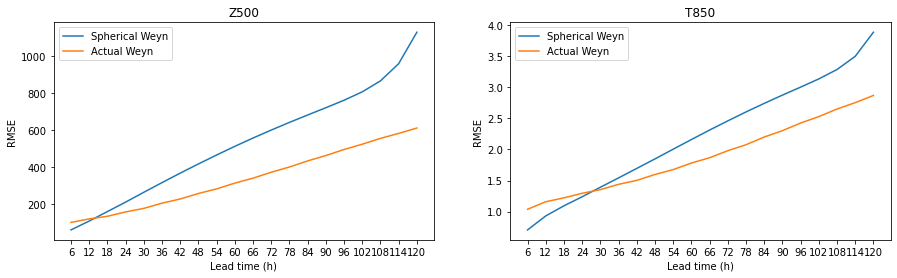

In [10]:
rmse_small, prediction_ds_small, obs_small, plot_params_small = \
        generate_predictions_ensemble('config_residual_one_step_small.json', nb_models=1, ensembling=False, swag=False, 
                                      last_epoch_only=True, load_if_exists=True, full_plots=False, hovmoller=False, 
                                      file_prefix='swag_small')

Reading confing file and setting up folders...
Loading data to RAM...
Time: 8.30s
Loading data to RAM...
Time: 2.26s
########Epoch 11########

Model 1
	Loading existing predictions
RMSE 
	Z500 - 0: 62.10675660215352
	T850 - 0: 0.7094966053166221


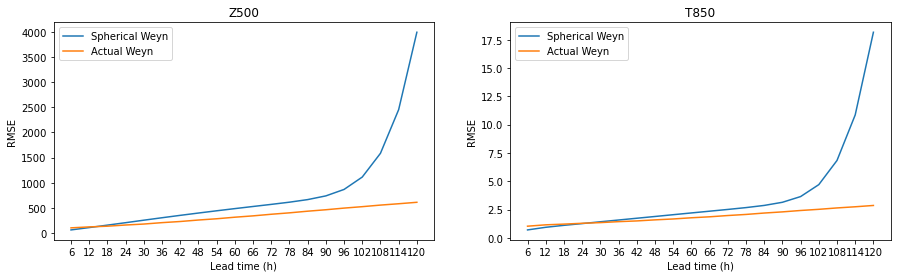

In [8]:
rmse_swag, prediction_ds_swag, obs_small, plot_params_swag = \
        generate_predictions_ensemble('config_residual_one_step_small.json', nb_models=1, ensembling=False, swag=True, 
                                      last_epoch_only=True, load_if_exists=True, full_plots=False, hovmoller=False, 
                                      file_prefix='swag_small')

Reading confing file and setting up folders...
Loading data to RAM...
Time: 6.68s
Loading data to RAM...
Time: 2.35s
########Epoch 11########

Model 1
	Loading existing predictions
RMSE
	Z500 - 0: 114.77244447640736
	T850 - 0: 0.734012898996028


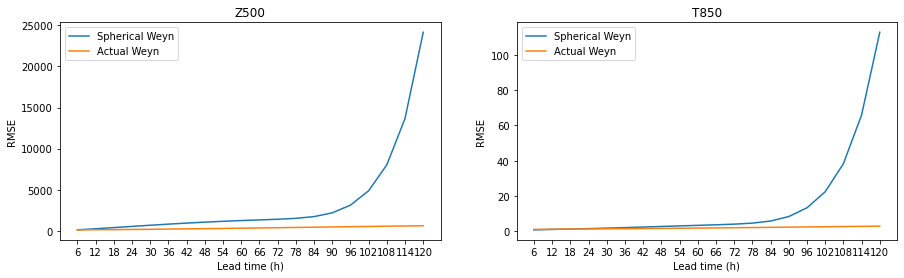

UnboundLocalError: local variable 'rmse_median' referenced before assignment

In [8]:
rmse_swag, prediction_ds_swag, obs_small, plot_params_swag = \
        generate_predictions_ensemble('config_residual_one_step_small.json', nb_models=1, ensembling=False, swag=True, 
                                      scale_swag=1.0, last_epoch_only=True, load_if_exists=True, full_plots=False, 
                                      hovmoller=False, file_prefix='swag_small')

Reading confing file and setting up folders...
Loading data to RAM...
Time: 2.14s
########Epoch 11########

Model 1
Processing lead time 20 out of 20
Saving to:  /mnt/scratch/students/haddad/weather_prediction/data/healpix/predictions/all_const_len2_delta_6_architecture_loss_v0_1steps_constant_increasing_static_l3_long_connections_per_epoch_swag_small_ensemble_model1_epoch11.nc

Model 2
Processing lead time 20 out of 20
Saving to:  /mnt/scratch/students/haddad/weather_prediction/data/healpix/predictions/all_const_len2_delta_6_architecture_loss_v0_1steps_constant_increasing_static_l3_long_connections_per_epoch_swag_small_ensemble_model2_epoch11.nc

Model 3
Processing lead time 20 out of 20
Saving to:  /mnt/scratch/students/haddad/weather_prediction/data/healpix/predictions/all_const_len2_delta_6_architecture_loss_v0_1steps_constant_increasing_static_l3_long_connections_per_epoch_swag_small_ensemble_model3_epoch11.nc

Model 4
Processing lead time 20 out of 20
Saving to:  /mnt/scratch/stu

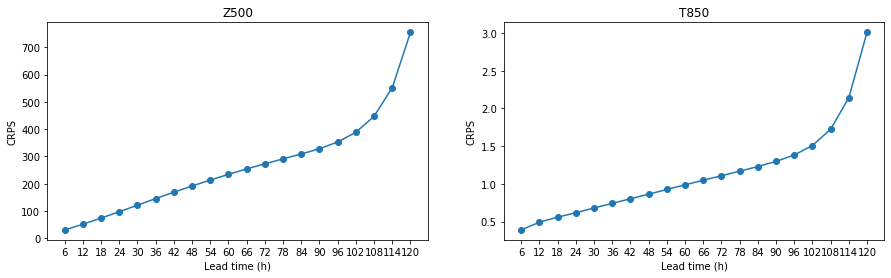

Percentage of observations in the ensemble interval
	Z500 : 72.907%
	T850 : 49.123%


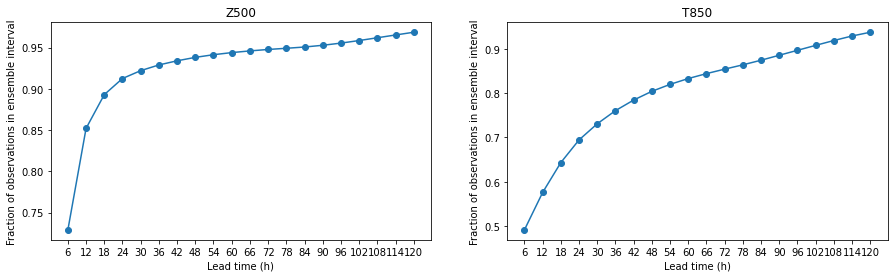

RMSE median
	Z500 - 0: 58.26321199071614
	T850 - 0: 0.6720431453722823


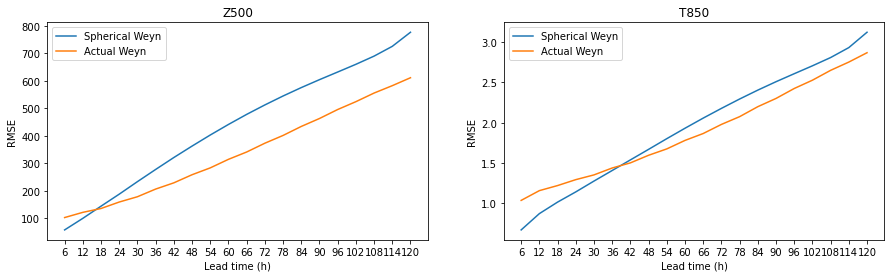

RMSE mean
	Z500 - 0: 58.41437928738871
	T850 - 0: 0.6694468956275625


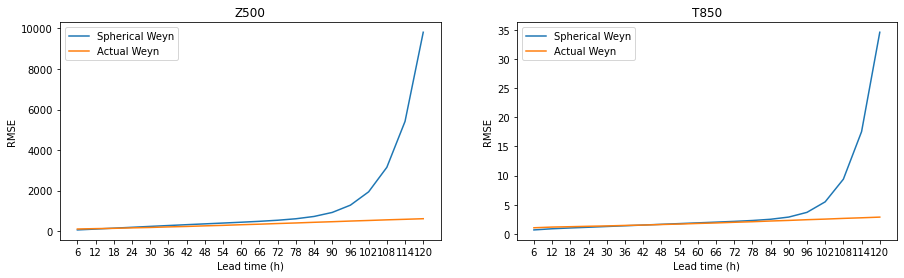

In [15]:
crps_results_ensemble_small, rmse_median_ensemble_small, rmse_mean_ensemble_small, prediction_ds_ensemble_small, \
prediction_mean_ds_ensemble_small, prediction_median_ds_ensemble_small, obs_ensemble_small, \
plot_params_ensemble_small = \
        generate_predictions_ensemble('config_residual_one_step_small.json', nb_models=10, ensembling=True, swag=False, 
                                      last_epoch_only=True, load_if_exists=False, full_plots=False, hovmoller=False, 
                                      file_prefix='swag_small')

Reading confing file and setting up folders...
Loading data to RAM...
Time: 7.16s
Loading data to RAM...
Time: 2.45s
########Epoch 11########

Model 1
	Loading existing predictions

Model 2
	Loading existing predictions

Model 3
	Loading existing predictions

Model 4
	Loading existing predictions

Model 5
	Loading existing predictions

Model 6
	Loading existing predictions

Model 7
	Loading existing predictions

Model 8
	Loading existing predictions

Model 9
	Loading existing predictions

Model 10
	Loading existing predictions

CRPS:
	Z500 : 33.557
	T850 : 0.414


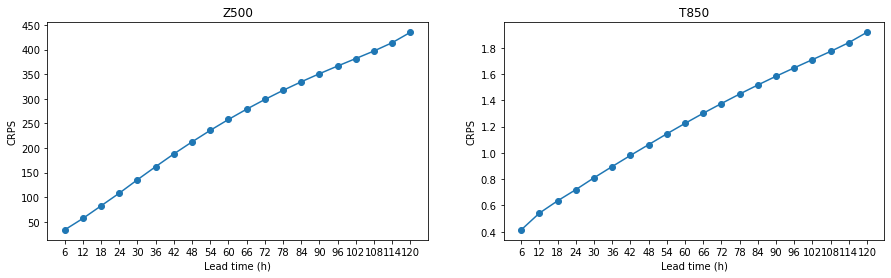

Percentage of observations in the ensemble interval
	Z500 : 52.973%
	T850 : 38.654%


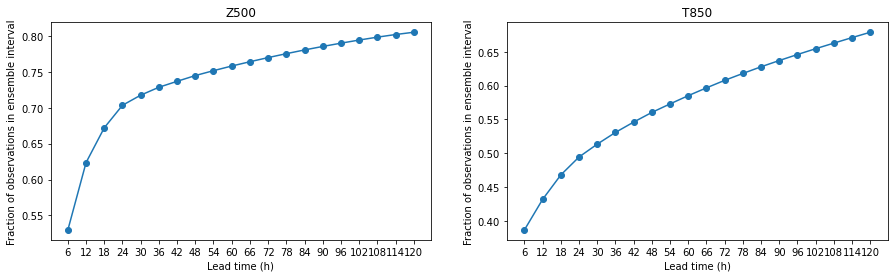

RMSE median
	Z500 - 0: 60.415662371885475
	T850 - 0: 0.686223192649585


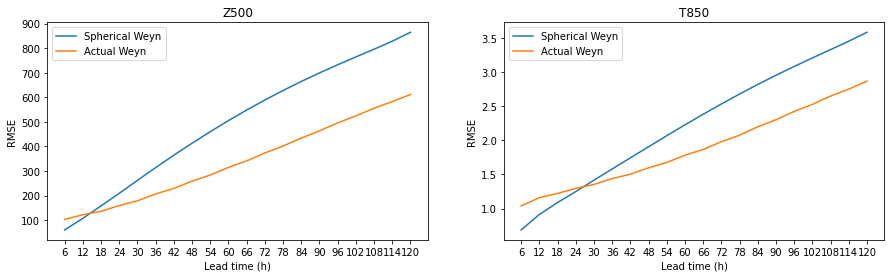

RMSE mean
	Z500 - 0: 60.46815544449939
	T850 - 0: 0.6849473918387229


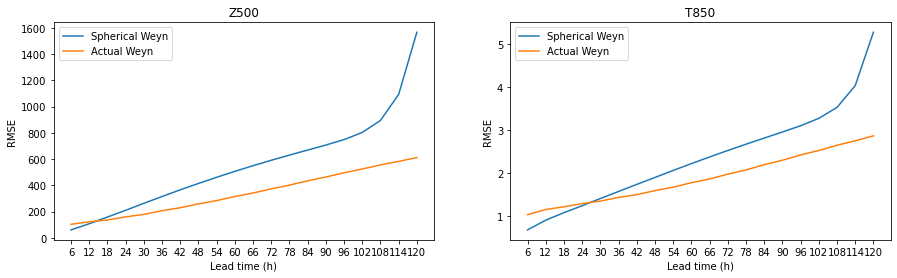

Median
loading data
time to load data:  501.5007104873657
time mean obs  30.41280508041382
time mean pred  39.324100494384766
time std obs  54.662880182266235
time std pred  60.007179260253906
time cov  67.6289610862732
time corre_map  0.004316806793212891
time rbias map  48.73940658569336
time rsd map  0.0021309852600097656
time rmse map  49.79582977294922
881.1775419712067


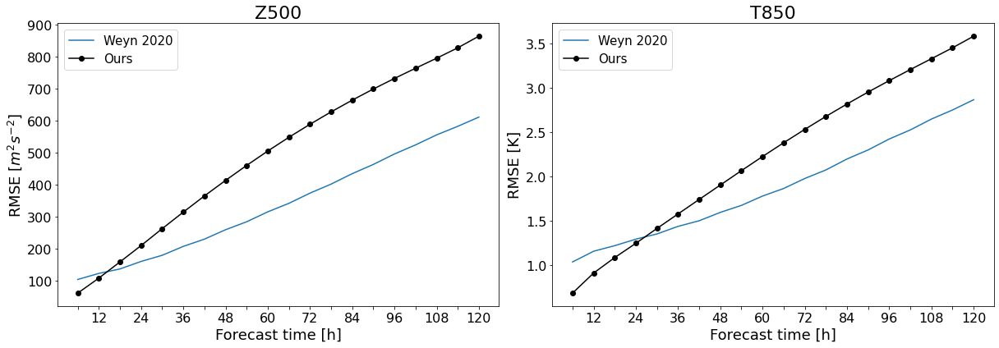

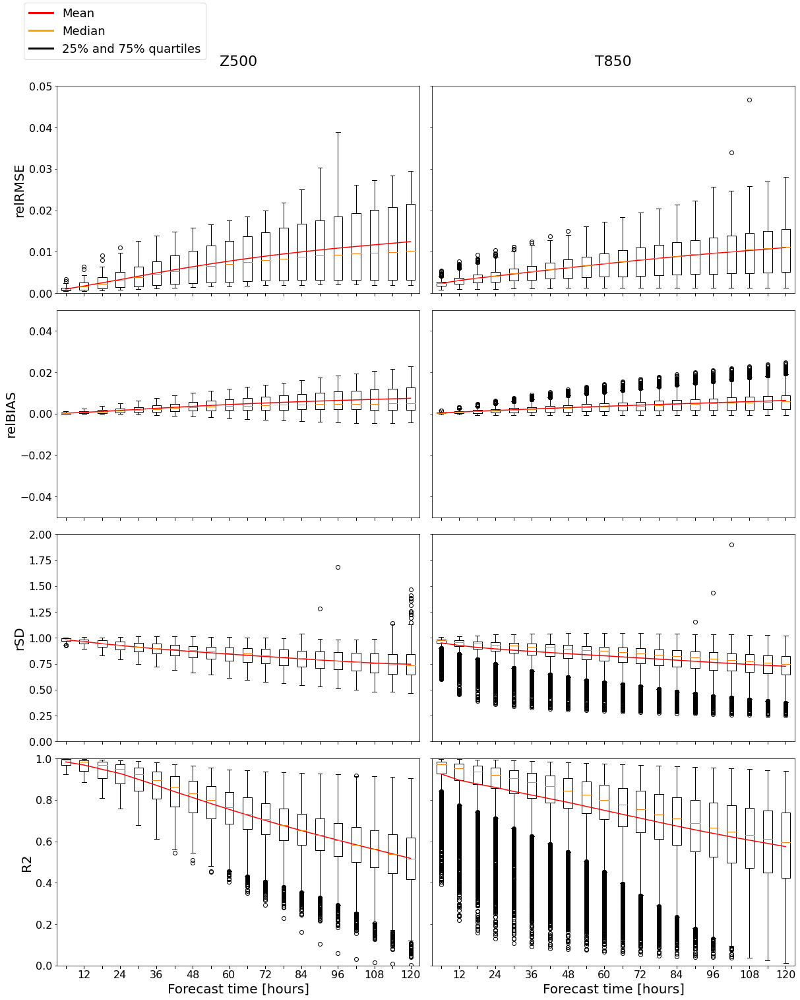

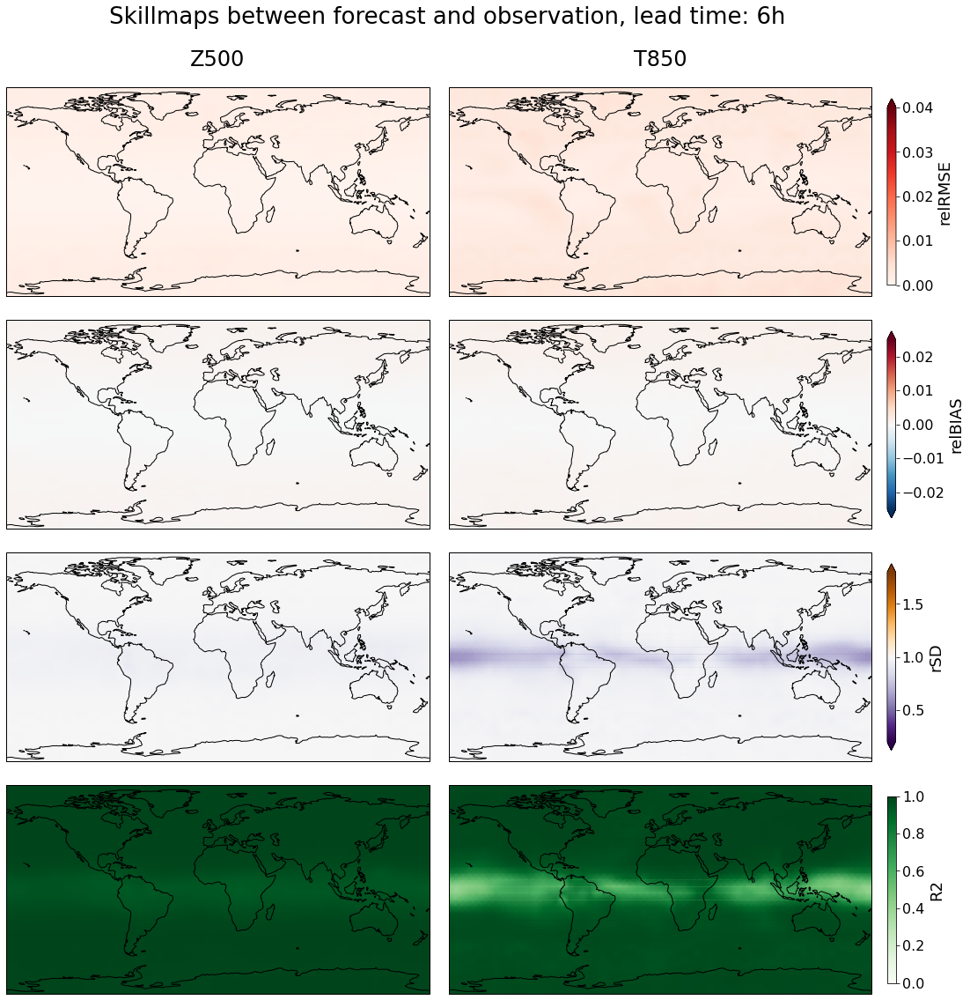

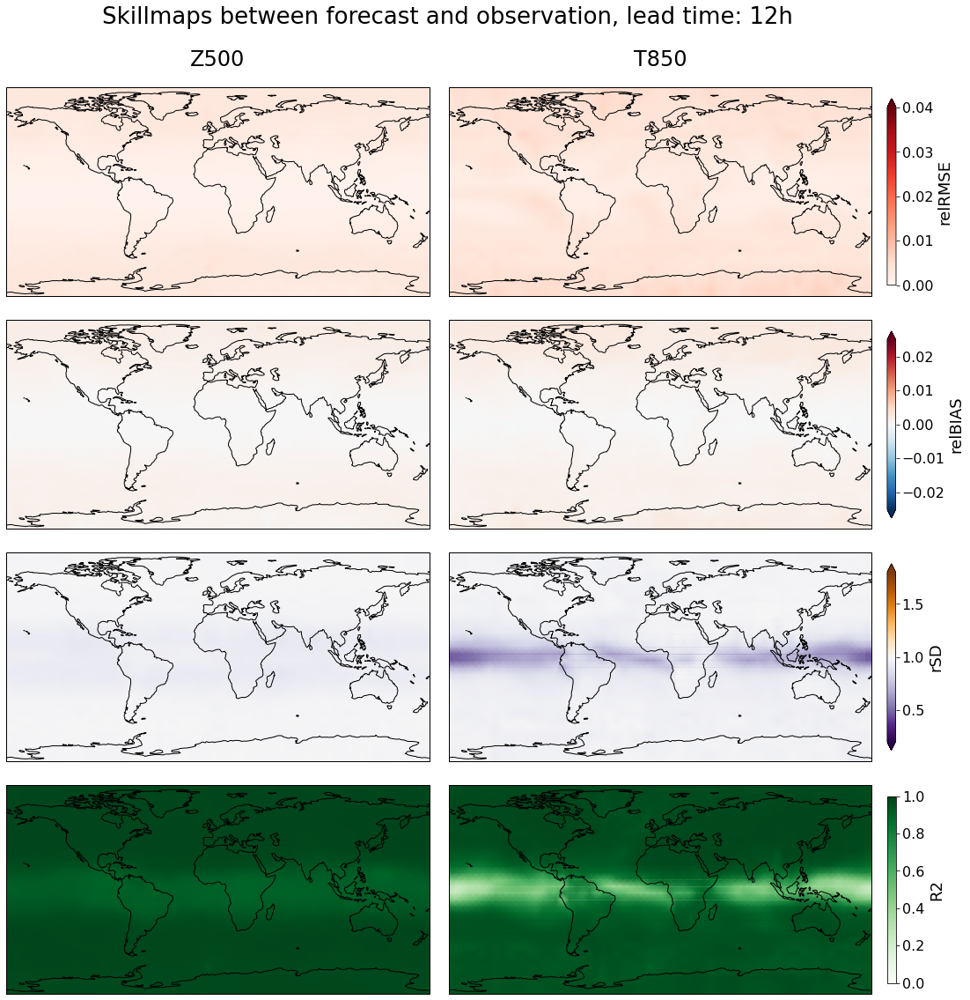

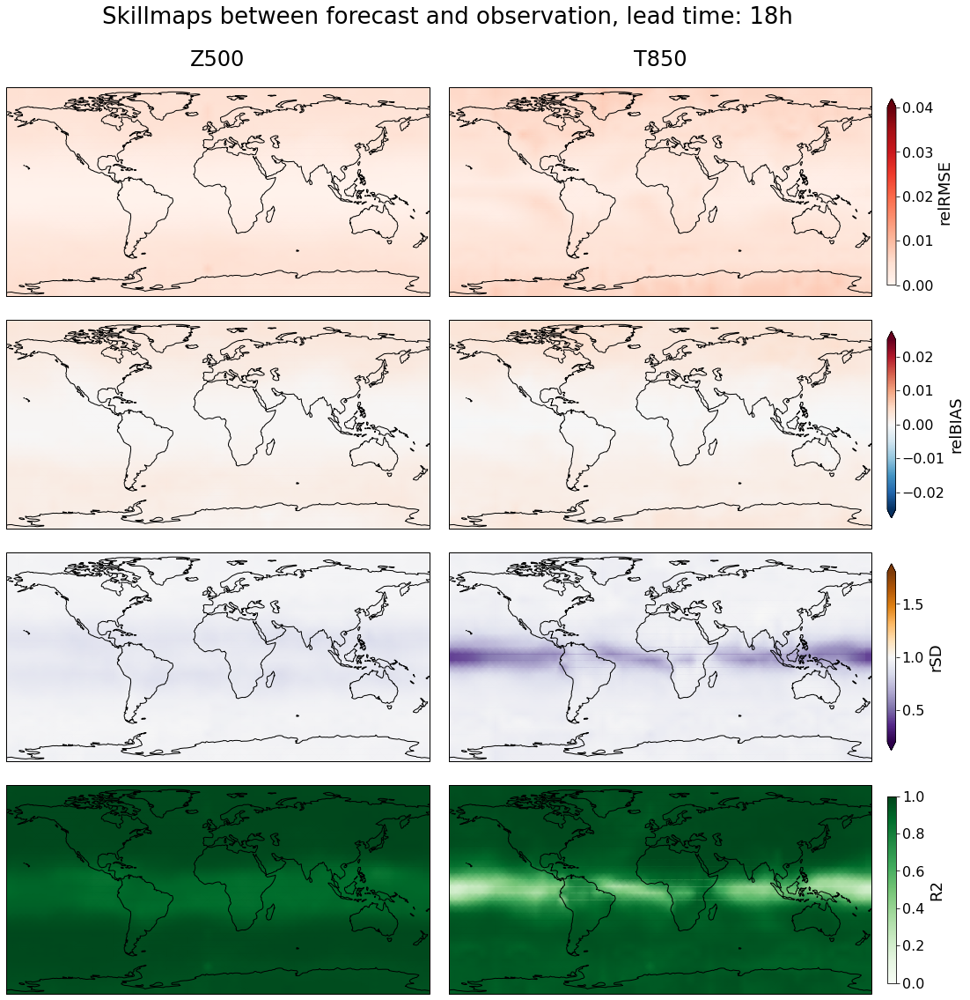

...

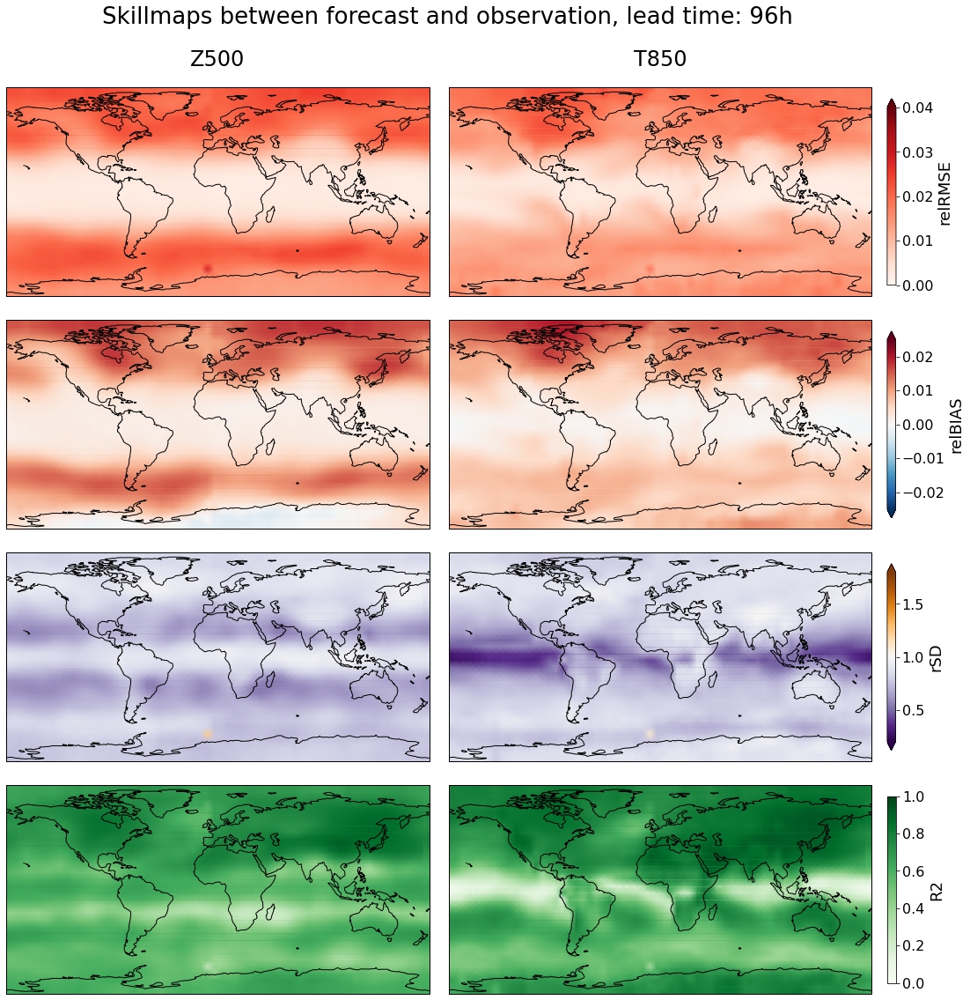

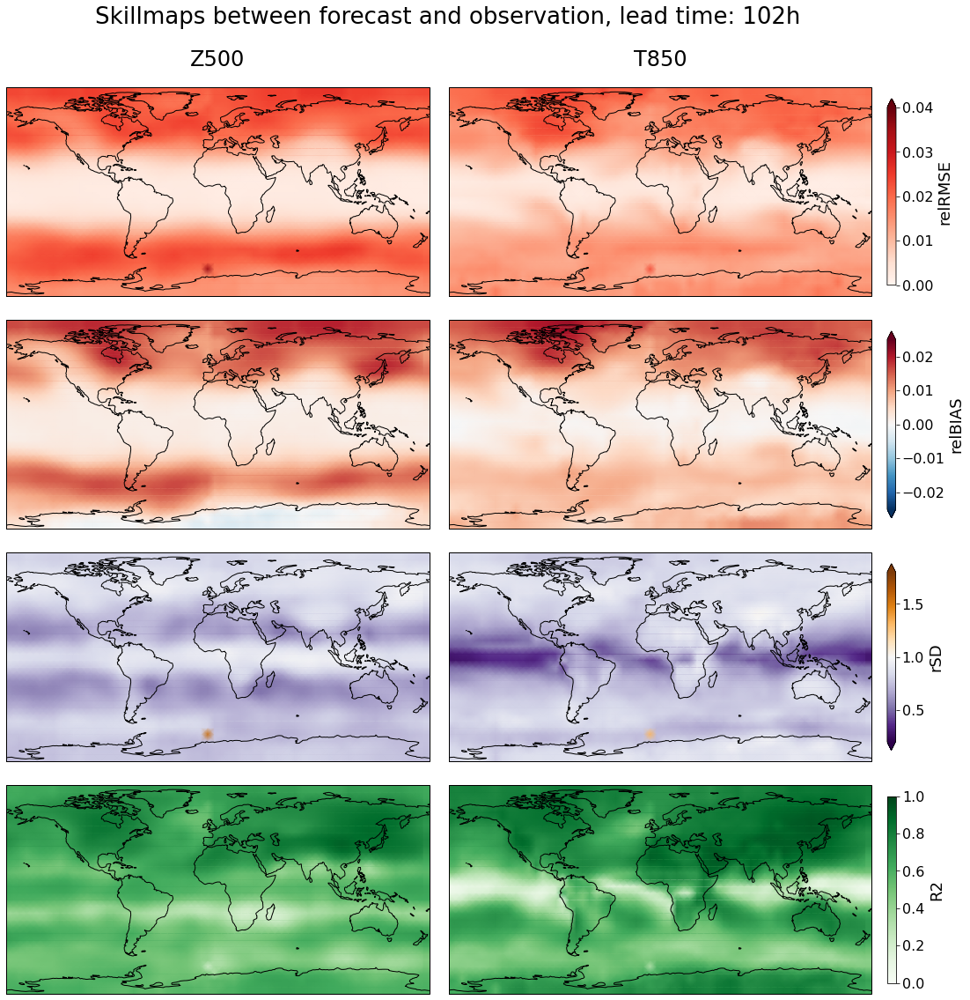

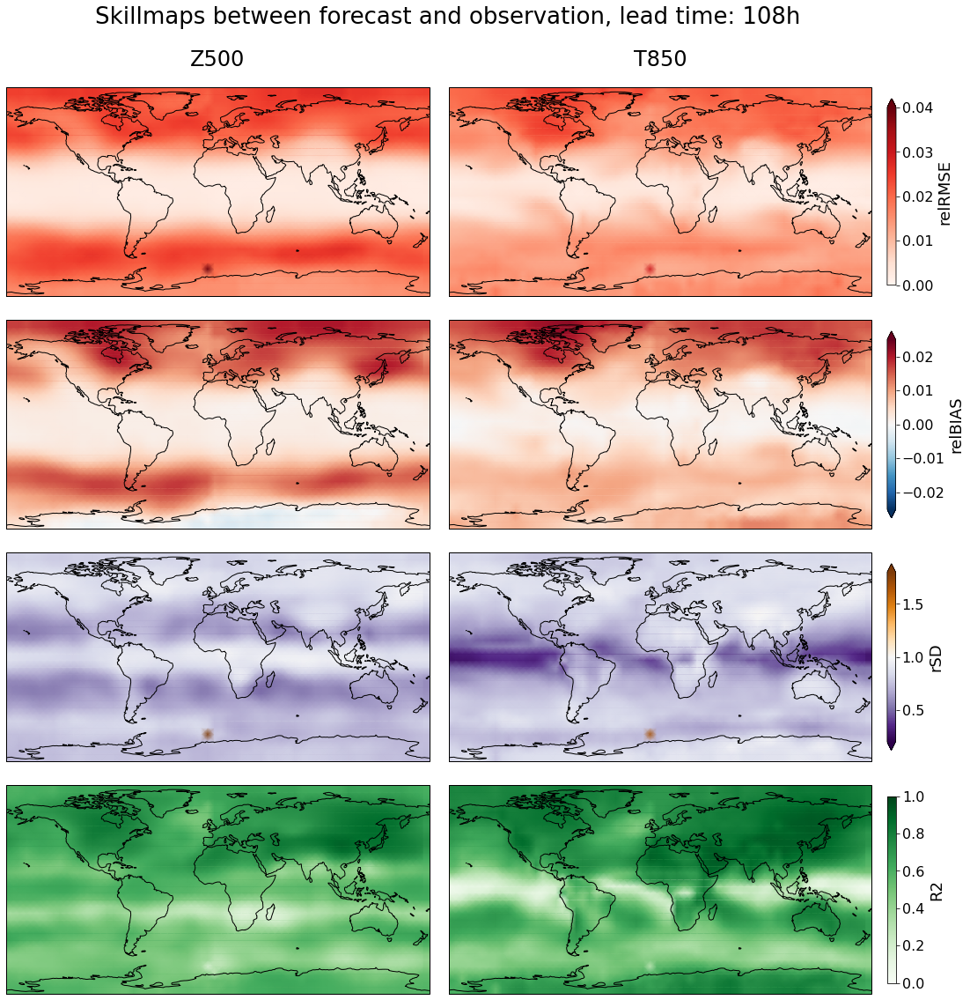

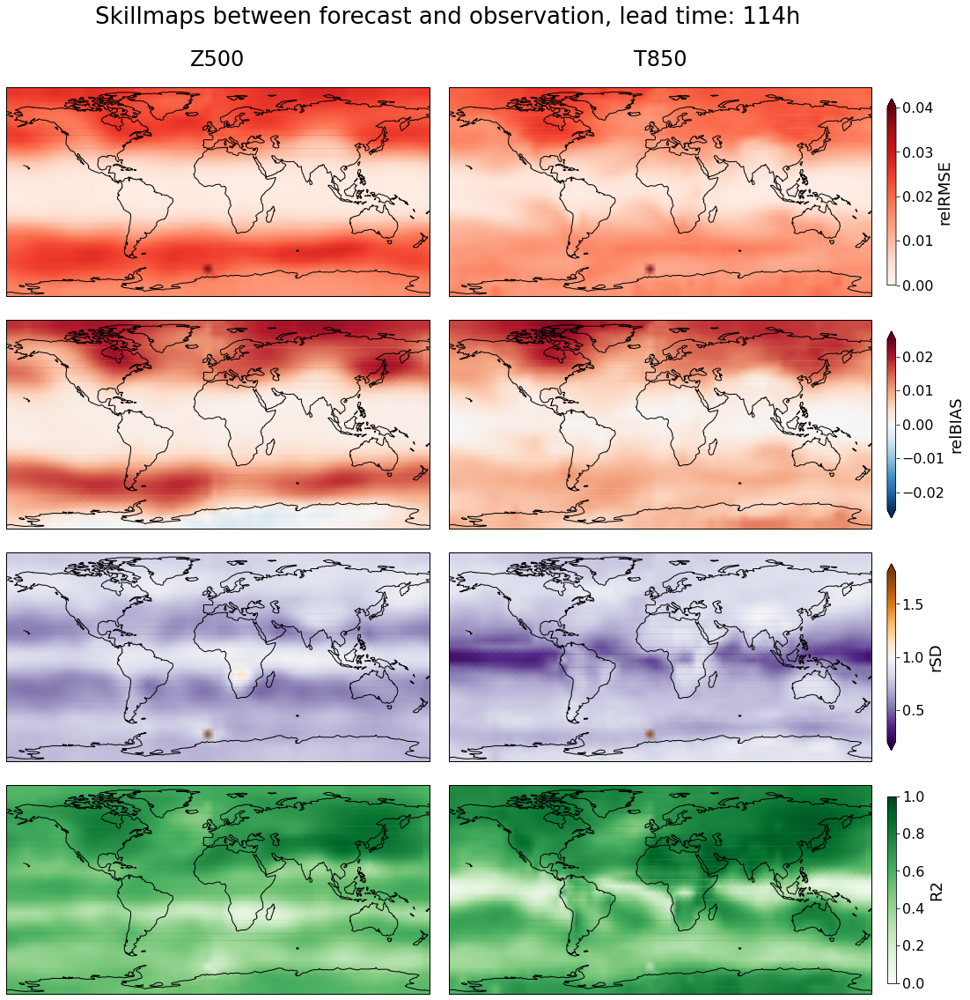

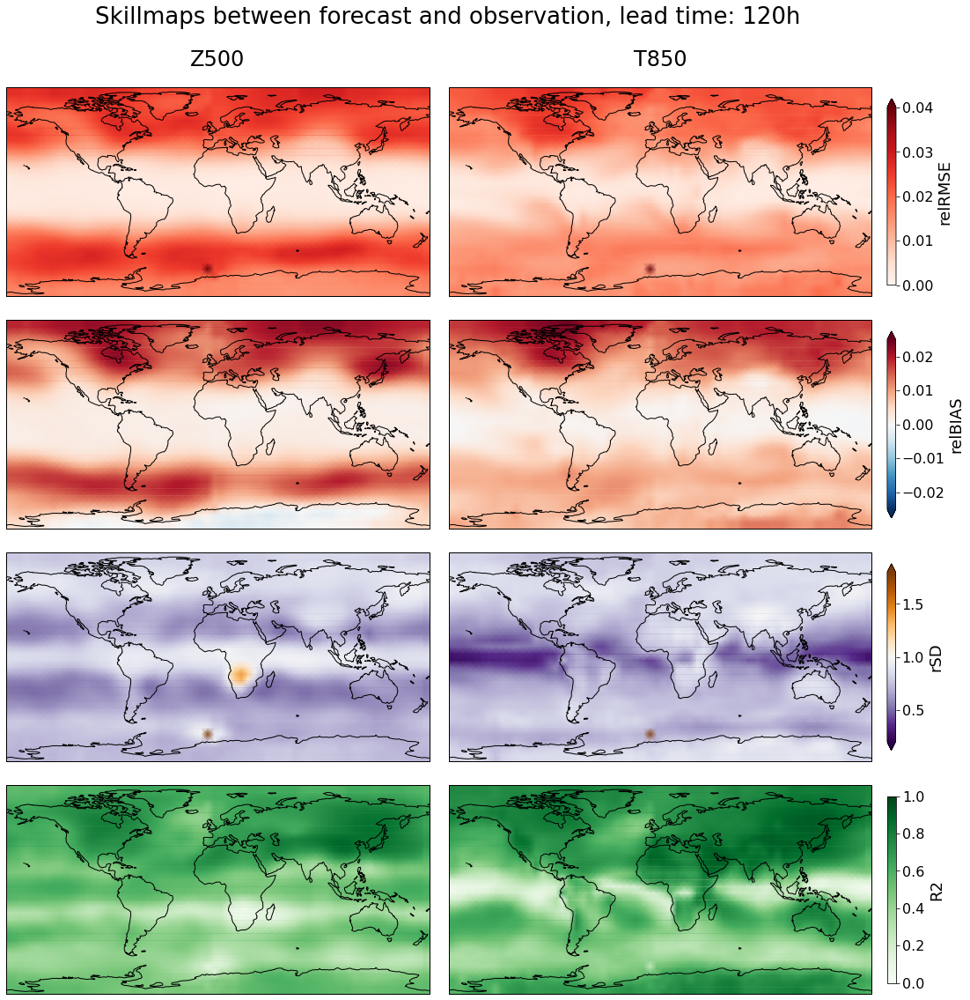

UnboundLocalError: local variable 'lead_times' referenced before assignment

In [3]:
_, _, _, _, _, _, _, plot_params_ensemble_small_swag = \
        generate_predictions_ensemble('config_residual_one_step_small.json', nb_models=10, ensembling=True, swag=True, 
                                      last_epoch_only=True, load_if_exists=True, full_plots=True, hovmoller=True, 
                                      file_prefix='swag_small')

In [4]:
import json
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

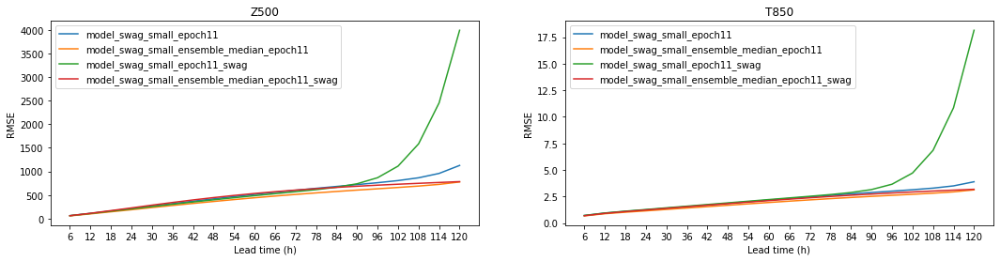

In [5]:
config_file = 'config_residual_one_step_small.json'
file_prefix = 'swag_small'
ep = 11
lead_time = 6
ensembling = True
swag = True

# load config
with open("../configs/" + config_file) as json_data_file:
    cfg = json.load(json_data_file)

# define paths
datadir = cfg['directories']['datadir']
input_dir = datadir + cfg['directories']['input_dir']
model_save_path = datadir + cfg['directories']['model_save_path']
pred_save_path = datadir + cfg['directories']['pred_save_path']
metrics_path = datadir + cfg['directories']['metrics_path']

# model parameters
max_lead_time = cfg['training_constants']['max_lead_time']
len_sqce = cfg['model_parameters']['len_sqce']
delta_t = cfg['model_parameters']['delta_t']
architecture_name = cfg['model_parameters']['architecture_name']

description_epoch = "all_const_len{}_delta_{}_architecture_".format(len_sqce, delta_t) + architecture_name
descriptions = []

base_label = 'model'
labels = []

if file_prefix:
    description_epoch += f'_{file_prefix}'
    base_label += f'_{file_prefix}'

descriptions.append(description_epoch + f'_epoch{ep}')
labels.append(base_label + f'_epoch{ep}')

if ensembling:
    descriptions.append(description_epoch + f'_ensemble_epoch{ep}')
    labels.append(base_label + f'_ensemble_median_epoch{ep}')

len_descriptions = len(descriptions)
if swag:
    for i in range(len_descriptions):
        descriptions.append(descriptions[i] + '_swag')
        labels.append(labels[i] + '_swag')
        
file_paths = []

for description in descriptions:
    if 'ensemble' in description:
        rmse_filename = datadir + 'metrics/rmse_' + description + '_median.nc'
    else:
        rmse_filename = datadir + 'metrics/rmse_' + description + '.nc'
        
    file_paths.append(rmse_filename)

rmses = []
    
for path in file_paths:
    rmse = xr.open_dataset(path)
    rmses.append(rmse)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 4))
    
lead_times = np.arange(lead_time, max_lead_time + lead_time, lead_time)

for i, rmse in enumerate(rmses):
    ax1.plot(lead_times, rmse.z.values, label=labels[i])
    
for i, rmse in enumerate(rmses):
    ax2.plot(lead_times, rmse.t.values, label=labels[i])

ax1.set_xlabel('Lead time (h)')
ax1.set_xticks(lead_times)
ax2.set_xticks(lead_times)
ax2.set_xlabel('Lead time (h)')
ax1.set_ylabel('RMSE')
ax2.set_ylabel('RMSE')
ax1.set_title('Z500')
ax2.set_title('T850')
ax1.legend()
ax2.legend()
plt.show()